<a href="https://colab.research.google.com/github/blueeagle100/stereo_vision_starter/blob/main/2_stereo_camera_calibration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Stereo Camera Calibration**

In this tutorial we will learn about stereo camera calibration in opencv. The code is based off of this [repository](https://github.com/niconielsen32/ComputerVision/tree/master/stereoVisionCalibration)

## **Background** 

TBD - possibly place background material in a new notebook

## **Stereo Calibration Procedure**

1. Calibrate Left and Right Cameras


A crucial piece of data needed for calibration is the set of 3D world points and their correpsonding 2D image locations. These points are usually easy to find locations such as corners of a chess board. An example is shown in figure 3.

If you would like some additional theory on how the projection matrix is estimated please see this excellent [video](https://www.youtube.com/watch?v=GUbWsXU1mac&list=PL2zRqk16wsdoCCLpou-dGo7QQNks1Ppzo&index=3)





## **Get data**

The data we will be using will come grom this Udacity repository https://github.com/udacity/CarND-Camera-Calibration

We will download it to our notebook using 'wget'

In [1]:
!wget https://stereo-vision.s3.eu-west-3.amazonaws.com/stereo_vision_data.zip

--2022-09-05 00:30:20--  https://stereo-vision.s3.eu-west-3.amazonaws.com/stereo_vision_data.zip
Resolving stereo-vision.s3.eu-west-3.amazonaws.com (stereo-vision.s3.eu-west-3.amazonaws.com)... 3.5.226.101
Connecting to stereo-vision.s3.eu-west-3.amazonaws.com (stereo-vision.s3.eu-west-3.amazonaws.com)|3.5.226.101|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 135956624 (130M) [application/zip]
Saving to: ‘stereo_vision_data.zip’

stereo_vision_data. 100%[===================>] 129.66M  20.2MB/s    in 16s     

2022-09-05 00:30:37 (7.90 MB/s) - ‘stereo_vision_data.zip’ saved [135956624/135956624]



In [ ]:
!unzip stereo_vision_data.zip

In [3]:
!ls

__MACOSX  sample_data  stereo_vision_data  stereo_vision_data.zip


#### Base Library Import

In [24]:
import os
from glob import glob
import cv2
import numpy as np
import pandas as pd
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams["figure.figsize"] = (20, 10)

Number of left Images: 30
Number of right Images: 30
Size of an image: (480, 640, 3)


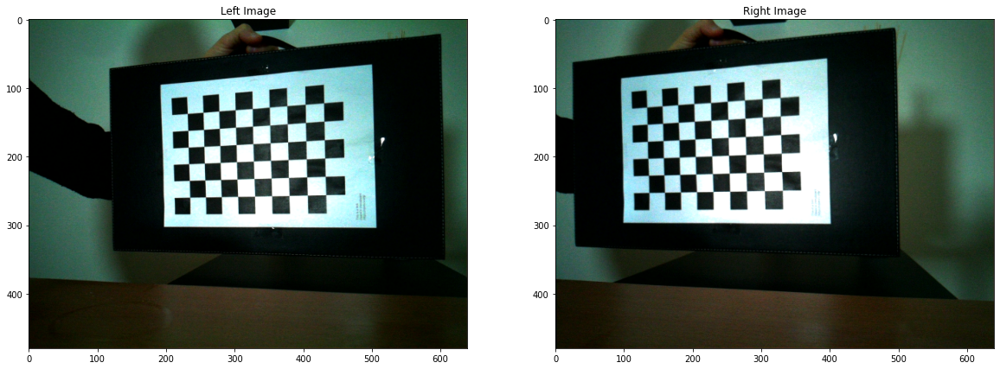

In [77]:
calibration_images = glob(r'CarND-Camera-Calibration-master/calibration_wide/GO*.png')


image_pathsL = sorted(glob(r'stereo_vision_data/Calibration/Image Pairs/pairs/left_*.png'))
image_pathsR = sorted(glob(r'stereo_vision_data/Calibration/Image Pairs/pairs/right_*.png'))

sample_imageL = mpimg.imread(image_pathsL[0])
sample_imageR = mpimg.imread(image_pathsR[0])
                                        
print(f'Number of left Images: {len(image_pathsL)}')
print(f'Number of right Images: {len(image_pathsL)}')
print(f'Size of an image: {sample_imageL.shape}')


_, (ax1, ax2) = plt.subplots(1, 2)
ax1.imshow(sample_imageL)
ax1.set_title('Left Image')
ax2.imshow(sample_imageR)
ax2.set_title('Right Image');

### Get some info about our calibration object

Calibration in opencv can be found [here](https://docs.opencv.org/4.x/dc/dbb/tutorial_py_calibration.html)

Looking at this picture, we can see that we have 6 rows and 8 columns. Typically when using our own pictures we would measure the distance of each square and account for it and get our calibration in terms of Millimeters. Since we ware using someone else's calibration data we can not do this. Instead we will just pass a 1 to square size and opencv will take care of the rest.

For more details see 
- https://docs.opencv.org/3.4/dc/dbb/tutorial_py_calibration.html
- https://stackoverflow.com/questions/37310210/camera-calibration-with-opencv-how-to-adjust-chessboard-square-size



In [26]:
rows = 6
columns = 9
square_size = 24 # square size in mm if known else 1

In [27]:
def associate_points_stereo(
                     image_pathsL: list, 
                     image_pathsR: list,
                     rows: int, 
                     cols: int,
                     square_size: float,
                     show: bool):
    ''' Associates real 3D object points with 2D image points for a set of 
        stereo image pairs. 
        Inputs:
            image_paths - contains filepaths for the calibration images
            rows - number of rows of calibration oobject
            cols - number of columns of the calibration object
            square_size - size of the calibration square in mm if known
                          If not known input a 1
        Outputs:
            obj_points - Associated 3D object points
            img_points - Associated 2D image points
        '''
    # prepare world object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((rows*cols, 3), np.float32)
    objp[:,:2] = np.mgrid[0:cols, 0:rows].T.reshape(-1,2)*square_size


    # Associate 3D object point with 2D image points

    # set termination criteria
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

    # Arrays to store object points and image points from all the images.
    obj_points = [] # 3d point in real world space
    img_pointsL = [] # 2d points in left image plane
    img_pointsR = [] # 2d points in right image plane

    for img_pathL, img_pathR in zip(image_pathsL, image_pathsR):
        # read in images
        imageL = cv2.imread(img_pathL)
        imageR = cv2.imread(img_pathR)
        grayL = cv2.cvtColor(imageL, cv2.COLOR_BGR2GRAY)
        grayR = cv2.cvtColor(imageR, cv2.COLOR_BGR2GRAY)

        # Find the chess board corners
        retL, cornersL = cv2.findChessboardCorners(grayL, (cols, rows), None)
        retR, cornersR = cv2.findChessboardCorners(grayR, (cols, rows), None)

        # If found, add object points, image points (after refining them)
        if retL and retR == True:

            # get corner with sub pixel accuracy
            cornersL = cv2.cornerSubPix(grayL, cornersL, (11,11), (-1,-1), criteria)
            cornersR = cv2.cornerSubPix(grayR, cornersR, (11,11), (-1,-1), criteria)

            # append to lists
            obj_points.append(objp)
            img_pointsL.append(cornersL)
            img_pointsR.append(cornersR)

            # Draw and display the corners
            if show:
                cv2.drawChessboardCorners(imageL, (cols, rows), cornersL, retL)
                cv2.drawChessboardCorners(imageR, (cols, rows), cornersR, retR)
                _, (ax1, ax2) = plt.subplots(1, 2)
                ax1.imshow(imageL)
                ax1.set_title('Left Image')
                ax2.imshow(imageR)
                ax2.set_title('Right Image')
                plt.show();
                cv2.waitKey(500)


    return obj_points, img_pointsL, img_pointsR


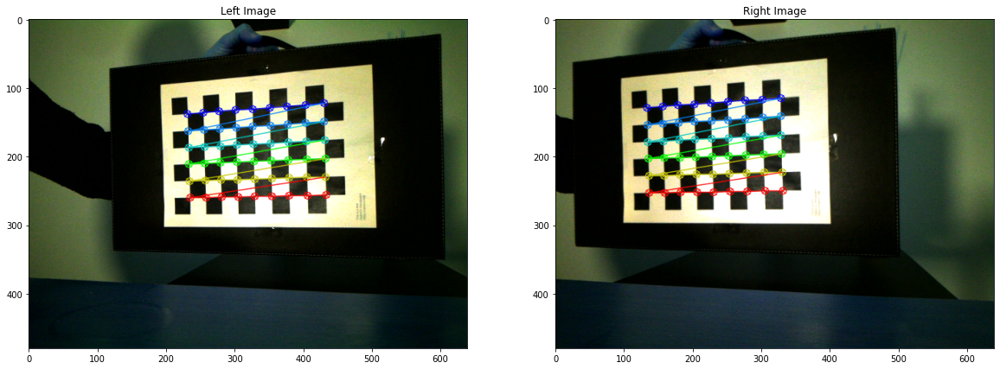

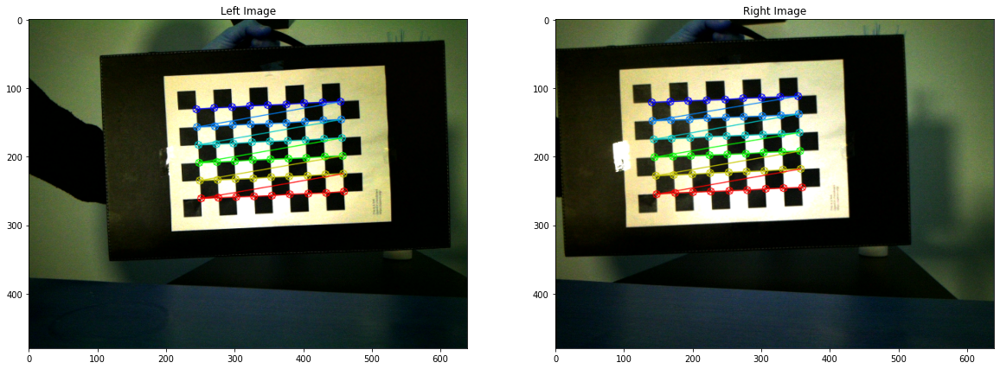

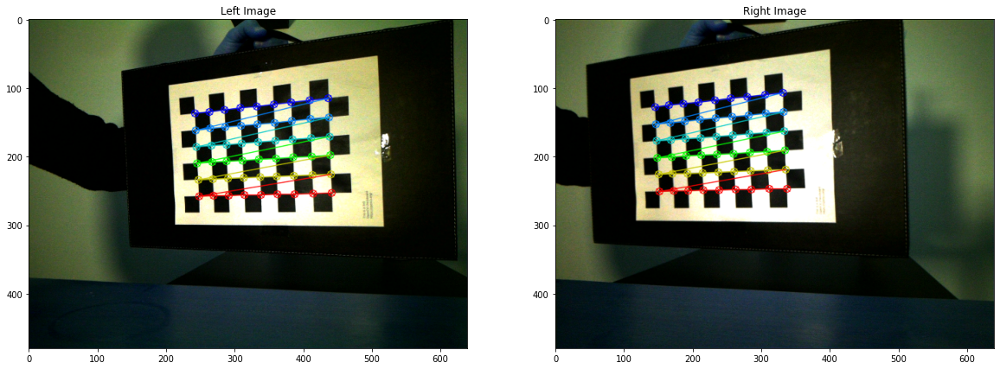

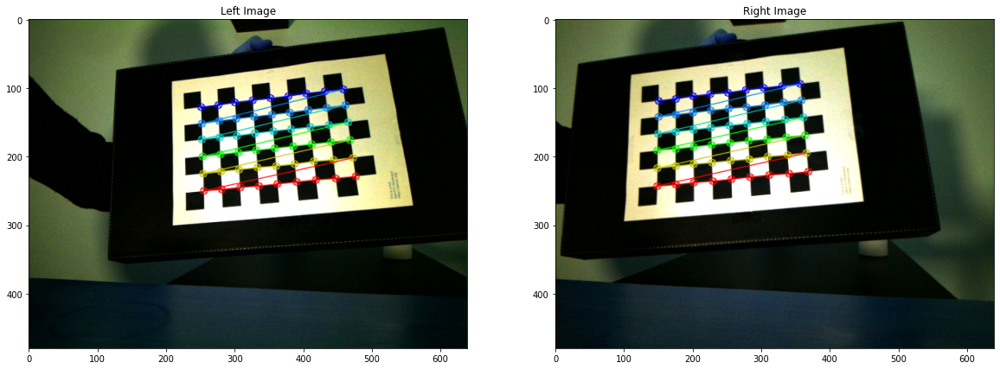

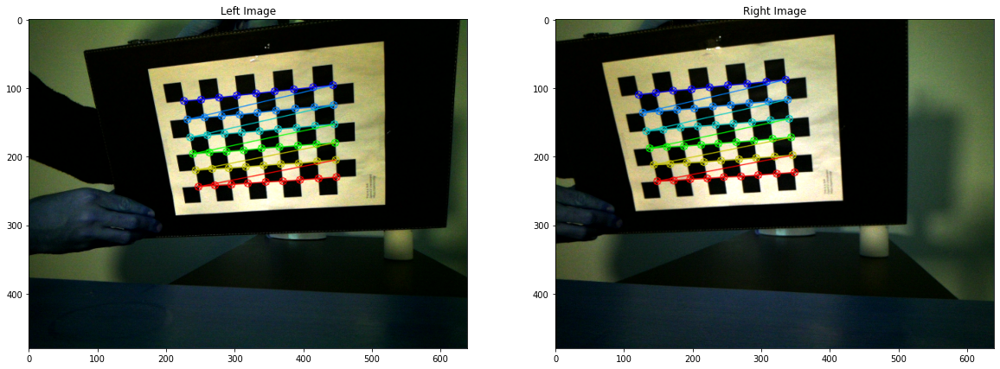

...

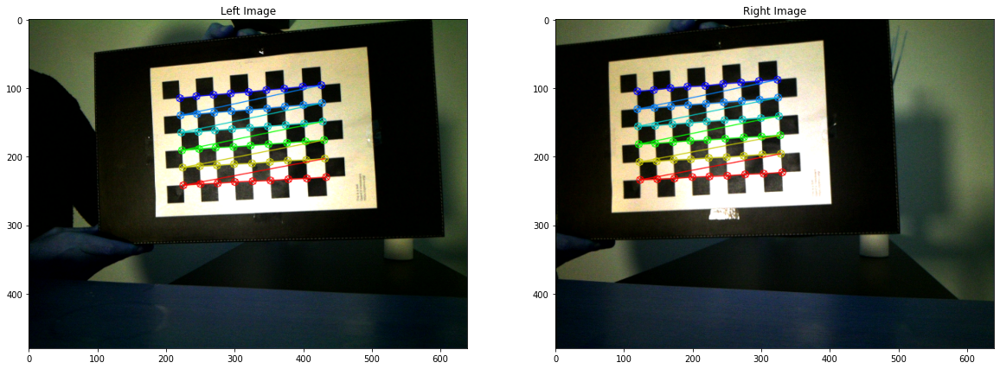

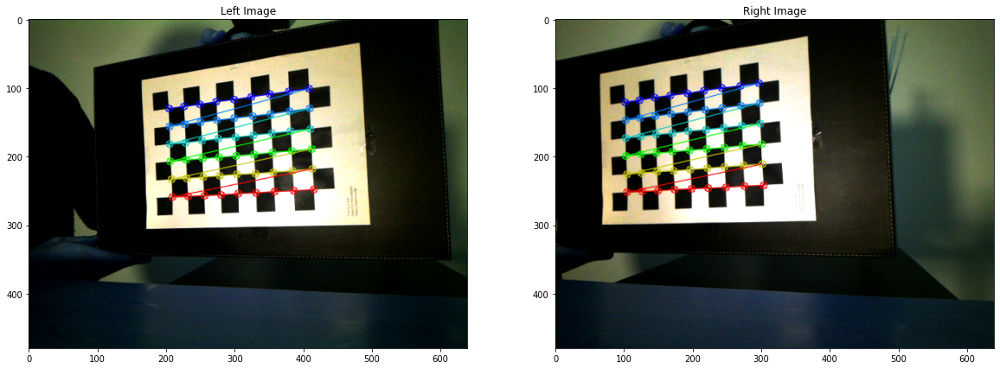

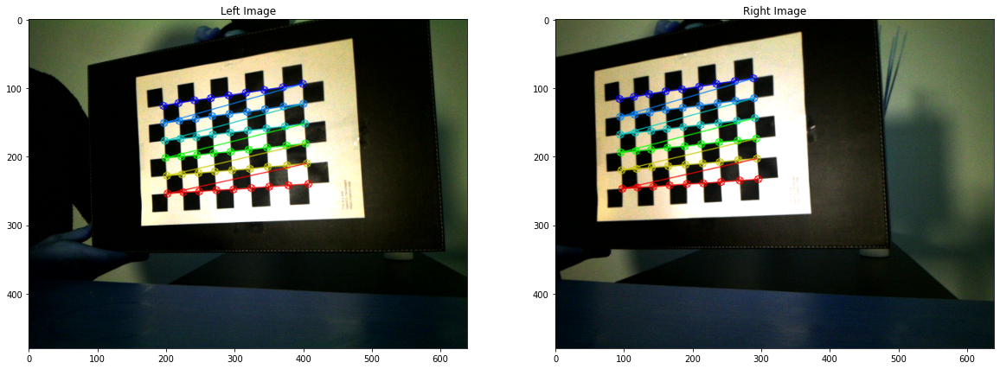

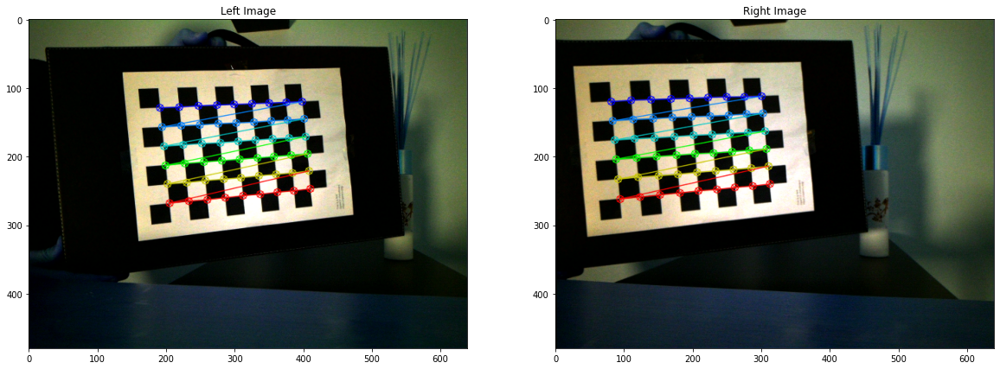

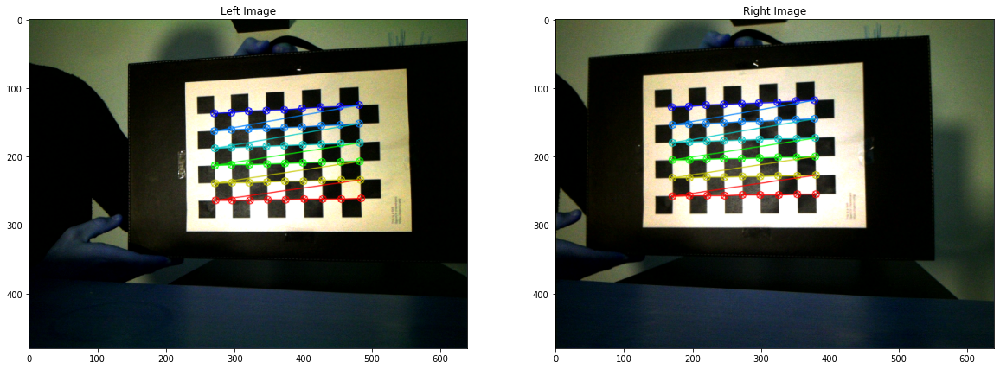

In [28]:
obj_points, img_pointsL, img_pointsR = associate_points_stereo(
                                                            image_pathsL, 
                                                            image_pathsR,
                                                            rows, 
                                                            columns,
                                                            square_size,
                                                            show=True)

## Now use opencv to get camera calibration infro

https://docs.opencv.org/4.x/d9/d0c/group__calib3d.html#ga687a1ab946686f0d85ae0363b5af1d7b

Make sure to study the documentation, since camera calibration tends to overfit we may or may not want to set flags to account for different distortions. Determining how to set the flags may take some trial and error. Also it may be beneficial to not use all of the images.

In [37]:
img_shape = (640, 480)

# try setting the flags in order to account distortion coefficients
flags = (cv2.CALIB_FIX_K1 + cv2.CALIB_FIX_K2 + cv2.CALIB_FIX_K3
         + cv2.CALIB_FIX_K4 + cv2.CALIB_FIX_K5 + cv2.CALIB_FIX_K6)
# flags = None

# get Camera Matrices and rotations
retL, cameraMatrixL, distL, rvecsL, tvecsL = cv2.calibrateCamera(obj_points, img_pointsL, img_shape, None, None, flags=flags)
retR, cameraMatrixR, distR, rvecsR, tvecsR = cv2.calibrateCamera(obj_points, img_pointsR, img_shape, None, None, flags=flags)

In [38]:
# This is the intrinsic Camera Matric K
cameraMatrixL

array([[556.63135627,   0.        , 328.20074099],
       [  0.        , 557.04673759, 240.15098705],
       [  0.        ,   0.        ,   1.        ]])

In [39]:
distR

array([[ 0.        ,  0.        , -0.00254198,  0.00845532,  0.        ]])

Notice how the distortion coefficients are close to 0? Try setting the uncommenting the flags to account for radial distortion and see how the distortion coefficients change.

Now let's test our calibration by using opencv to undistort the images

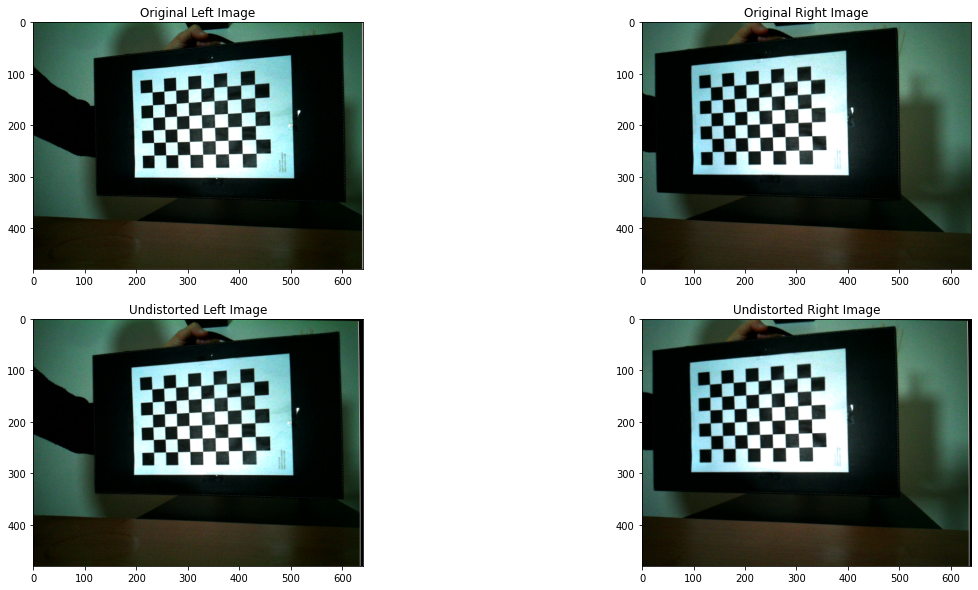

In [40]:
undistortedL = cv2.undistort(sample_imageL, cameraMatrixL, distL, None, cameraMatrixL)
undistortedR = cv2.undistort(sample_imageR, cameraMatrixR, distL, None, cameraMatrixR)

# Display the image before and after distortion
_, ax = plt.subplots(2, 2)
ax[0, 0].imshow(sample_imageL)
ax[0, 0].set_title("Original Left Image")
ax[0, 1].imshow(sample_imageR)
ax[0, 1].set_title("Original Right Image")
ax[1, 0].imshow(undistortedL)
ax[1, 0].set_title("Undistorted Left Image")
ax[1, 1].imshow(undistortedR)
ax[1, 1].set_title("Undistorted Right Image")
plt.show()

Now we have the information that we need to undistort the images. We can save the Intrinsic Camera Matrix and distortion coefficients and use them to undistort all of our future iamge frames!

Now we will use opencv's [getOptinalNewCameraMatrix](https://docs.opencv.org/3.4/d9/d0c/group__calib3d.html#ga7a6c4e032c97f03ba747966e6ad862b1)

In [41]:
newCameraMatrixL, roi_L = cv2.getOptimalNewCameraMatrix(cameraMatrixL, distL, img_shape, 1, img_shape)
newCameraMatrixR, roi_R = cv2.getOptimalNewCameraMatrix(cameraMatrixR, distR, img_shape, 1, img_shape)

## **Stereo Vision Calibration**

We will use [stereoCalibrate](https://docs.opencv.org/3.4/d9/d0c/group__calib3d.html#ga91018d80e2a93ade37539f01e6f07de5) which finds the transformation between the stereo camera pair, the Essential matrix and the Fundamental matrix

In [42]:

# since we have already calibrated our cameras we set the flag CALIB_FIX_INTRINSIC
flags = 0
flags |= cv2.CALIB_FIX_INTRINSIC
# Here we fix the intrinsic camara matrixes so that only Rot, Trns, Emat and Fmat are calculated.
# Hence intrinsic parameters are the same 

criteria_stereo= (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# This step is performed to transformation between the two cameras and calculate Essential and Fundamenatl matrix
retStereo, newCameraMatrixL, distL, newCameraMatrixR, distR, \
rot, trans, essentialMatrix, fundamentalMatrix = cv2.stereoCalibrate(obj_points, img_pointsL, img_pointsR, newCameraMatrixL, 
                                                                     distL, newCameraMatrixR, distR, img_shape, criteria_stereo, flags)



## **Stereo Rectification**

To perform the image rectification we use [stereoRectify](https://docs.opencv.org/3.4/d9/d0c/group__calib3d.html#ga617b1685d4059c6040827800e72ad2b6) which computes the rotation matrices for each camera that (virtually) make both camera image planes the same plane.

[initUndistortRectifyMap](https://docs.opencv.org/3.4/da/d54/group__imgproc__transform.html#ga7dfb72c9cf9780a347fbe3d1c47e5d5a)

In [44]:
rectifyScale= 1
rectL, rectR, projMatrixL, projMatrixR, Q, roi_L, roi_R = cv2.stereoRectify(newCameraMatrixL, 
                                                                            distL, 
                                                                            newCameraMatrixR, 
                                                                            distR, 
                                                                            img_shape, 
                                                                            rot, 
                                                                            trans, 
                                                                            rectifyScale,
                                                                            (0,0))

stereoMapL = cv2.initUndistortRectifyMap(newCameraMatrixL, distL, rectL, projMatrixL, img_shape, cv2.CV_16SC2)
stereoMapR = cv2.initUndistortRectifyMap(newCameraMatrixR, distR, rectR, projMatrixR, img_shape, cv2.CV_16SC2)

# we can save these parameters for future use
# print("Saving parameters!")
# cv_file = cv.FileStorage('stereoMap.xml', cv.FILE_STORAGE_WRITE)

# cv_file.write('stereoMapL_x',stereoMapL[0])
# cv_file.write('stereoMapL_y',stereoMapL[1])
# cv_file.write('stereoMapR_x',stereoMapR[0])
# cv_file.write('stereoMapR_y',stereoMapR[1])

# cv_file.release()

# and we can access them like this
# cv_file = cv2.FileStorage()
# cv_file.open('stereoMap.xml', cv2.FileStorage_READ)

# stereoMapL_x = cv_file.getNode('stereoMapL_x').mat()
# stereoMapL_y = cv_file.getNode('stereoMapL_y').mat()
# stereoMapR_x = cv_file.getNode('stereoMapR_x').mat()
# stereoMapR_y = cv_file.getNode('stereoMapR_y').mat()


## **Test Stereo Calibration**

To undistort and rectify the images, we will use [remap](https://docs.opencv.org/3.4/da/d54/group__imgproc__transform.html#gab75ef31ce5cdfb5c44b6da5f3b908ea4)

In [46]:
stereoMapL_x = stereoMapL[0]
stereoMapL_y = stereoMapL[1]

stereoMapR_x = stereoMapR[0]
stereoMapR_y = stereoMapR[1]


In [80]:
# Undistort and rectify images
correctedL = cv2.remap(sample_imageL, stereoMapL_x, stereoMapL_y, cv2.INTER_LANCZOS4, cv2.BORDER_CONSTANT, 0)
correctedR = cv2.remap(sample_imageR, stereoMapR_x, stereoMapR_y, cv2.INTER_LANCZOS4, cv2.BORDER_CONSTANT, 0)

In [81]:
# convert from float32 to uint8
sample_imageL = cv2.normalize(sample_imageL, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)
sample_imageR = cv2.normalize(sample_imageR, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)

correctedL = cv2.normalize(correctedL, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)
correctedR = cv2.normalize(correctedR, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)

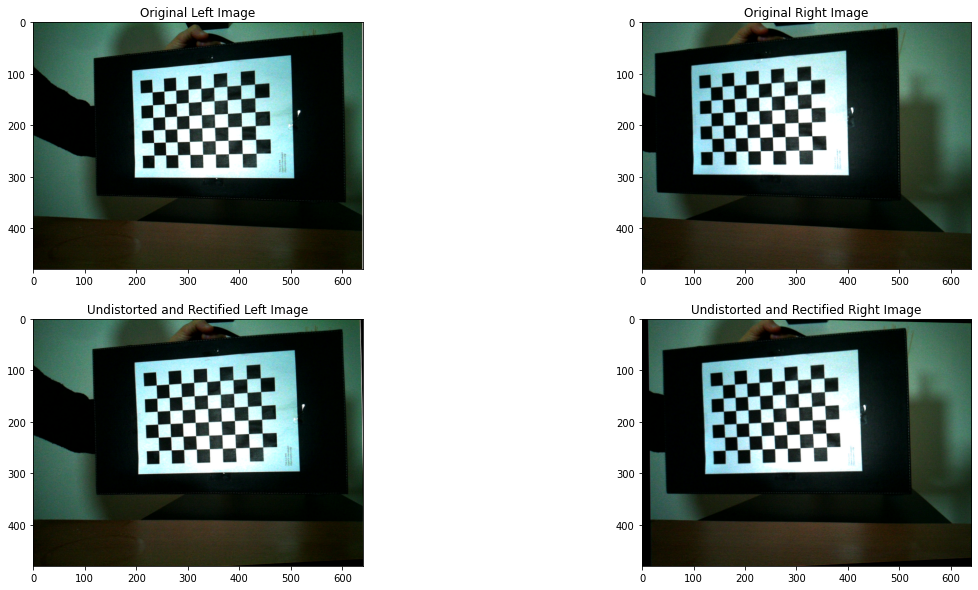

In [82]:
# Display the image before and after distortion
_, ax = plt.subplots(2, 2)
ax[0, 0].imshow(sample_imageL)
ax[0, 0].set_title("Original Left Image")
ax[0, 1].imshow(sample_imageR)
ax[0, 1].set_title("Original Right Image")
ax[1, 0].imshow(correctedL)
ax[1, 0].set_title("Undistorted and Rectified Left Image")
ax[1, 1].imshow(correctedR)
ax[1, 1].set_title("Undistorted and Rectified Right Image");

In [83]:
# try drawing on the image
cv2.circle(sample_imageL, (300, 250), 5, (255, 0, 0), -1);
cv2.circle(sample_imageR, (300, 250), 5, (255, 0, 0), -1);
cv2.circle(correctedL, (300, 250), 5, (255, 0, 0), -1);
cv2.circle(correctedR, (300, 250), 5, (255, 0, 0), -1);

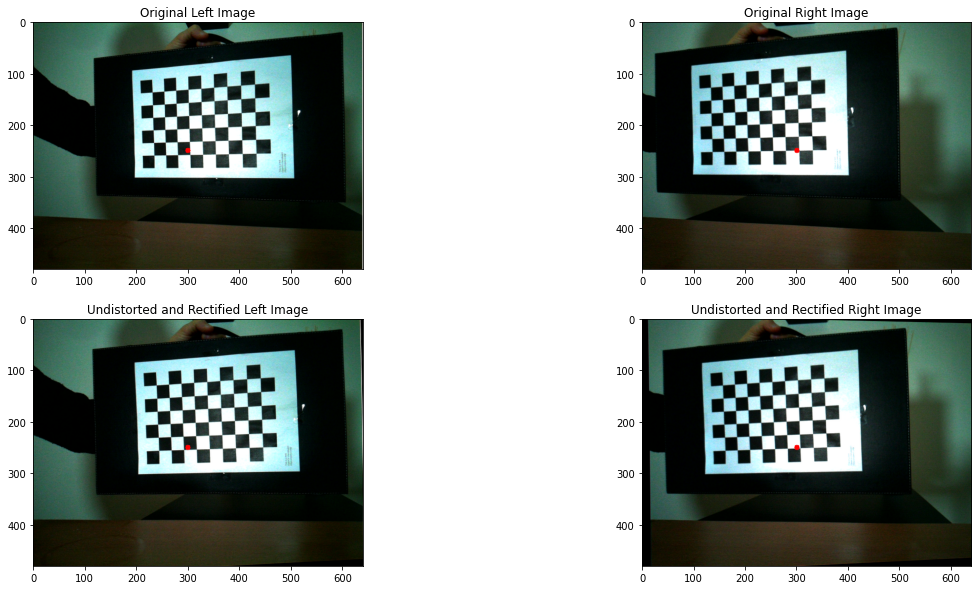

In [84]:
# Display the image before and after distortion
_, ax = plt.subplots(2, 2)
ax[0, 0].imshow(sample_imageL)
ax[0, 0].set_title("Original Left Image")
ax[0, 1].imshow(sample_imageR)
ax[0, 1].set_title("Original Right Image")
ax[1, 0].imshow(correctedL)
ax[1, 0].set_title("Undistorted and Rectified Left Image")
ax[1, 1].imshow(correctedR)
ax[1, 1].set_title("Undistorted and Rectified Right Image");

The images look very similar, but we can notice after calibration and rectification, the red dot appears closer to the same x-axis